![](https://dbuscombe-usgs.github.io/MLMONDAYS/img/favicon.ico)

# ML-Mondays. Week 1: Supervised Image Recognition


See the [course website](https://dbuscombe-usgs.github.io/MLMONDAYS/) for more information

>A) Live session (***this notebook***): we'll work through jupyter notebooks containing workflows for image recognition (whole image classification). We'll be trying to answer the question, How much of the Texas coastline is developed?. To answer this question, we will train a deep learning model to classify aerial (oblique) images of the Texas coast, categorized into several natural and non-natural landuse/cover classes. See the [data page](https://dbuscombe-usgs.github.io/MLMONDAYS/docs/doc2) for more information on the dataset.

>B) Optional class assignment: an additional dataset will be provided that you can work on using the same models introduced in the class. The NWPU-RESISC45 is a publicly available benchmark for REmote Sensing Image Scene Classification (RESISC), created by Northwestern Polytechnical University (NWPU). We have curated a version of this dataset covering 11 scene classes. This dataset contains 7,700 images, with 700 images in each class. Participants will also be encouraged to adapt what they learned in the class to their own image recognition problems using their own data.

## Written by Daniel Buscombe

![](https://mardascience.com/wp-content/uploads/2019/06/cropped-MardaScience_logo-5.png)

MIT License

Copyright (c) 2020, Marda Science LLC

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

In this lesson, we will train a neural network 'end to end' in an extremely discriminative approach that explicitly maps the classes to the image features, and optimized to extract the features that explicitly predict the class. The network works by linking an image feature extractor to a classifying head, such that feature extraction is limited to only those that help predict the class. The feature extraction therefore results in classification directly. 

For datasets where classes are obviously distinct, this is an extremely successful approach. We will see this with the NWPU dataset. However, for the TAMUCC dataset, where there is a lot more variability within classes and a lot less variability within classes, we will see how successful this approach is.

Clone the github repository:

In [1]:
!git clone --depth 1 https://github.com/dbuscombe-usgs/MLMONDAYS.git

Cloning into 'MLMONDAYS'...
remote: Enumerating objects: 559, done.
remote: Counting objects: 100% (559/559), done.
remote: Compressing objects: 100% (534/534), done.
remote: Total 559 (delta 31), reused 521 (delta 17), pack-reused 0
Receiving objects: 100% (559/559), 3.15 GiB | 40.04 MiB/s, done.
Resolving deltas: 100% (31/31), done.
Checking out files: 100% (570/570), done.


> ML Mondays overview

Access the slides [here](https://docs.google.com/presentation/d/1lyZ0YAzP-9pLLTyAuwBgmD7uBO83MkJF1e-Ps3xXlgs/edit?usp=sharing)


Import the `os` library and use it to change directory, just like you might do from the command line

In [2]:
import os
os.chdir('MLMONDAYS/1_ImageRecog')

#### Download the data

In [ ]:
#! python download_data.py

The following notebook is equivalent (in result) to running the following script inside this directory, which you could do by uncommenting and running the cell below


In [3]:
# !python tamucc_dataviz.py

In [4]:
%%html --isolated 

<style>

* {
    color: red;
}

</style>


<h2>(WARNING! it will take a long time ...)</h2>
<p>(so please don't do this in class!)</p>


## 1) Introduction

Brief introduction to the topic; the types of problems it is designed to solve; the types of data that are suitable; and a brief tour of where this technique fits in the general workflow for the course, and the general machine learning landscape.


What follows is merely an illustration of the types of analyses you could carry out to visualize your imagery and the classes. I strongly encourage you to develop your own. This may necessarily result from the nature of the data and classes.

Okay, first we'll define some variables 

* `VALIDATION_SPLIT` is the proportion of the dataset used for model validation. The rest will be used for model training. In principle, the higher the validation split, the better, because the model is using only the remaining fraction to train. High accuracies with high validation splits will generalize well to unseen data. With high accuracies obtained with relatively low validation splits, say less than 0.5, it is indeterminate how well the model will generalize to unseen data.

* `TARGET_SIZE` is the horizontal image dimension used by model training and subsequent prediction. The program will crop provided imagery to square, then scale (typically downscale) from the provided image dimension to the `TARGET_SIZE`. This number might seem small: it is, in order to fit in GPU memory. That said, you'll be surprised how much you can downsize your imagery and have its salient and distinguishing features preserved 
* `ims_per_shard`. The number of images encoded in each TFRecord shard. This is optional, but knowledge of this helps optimize the throughput of imagery on the GPU




In [5]:
VALIDATION_SPLIT = 0.6

#start small - can increase later with larger hardware
TARGET_SIZE= 400

ims_per_shard = 200

There are a lot of libraries and functions that get imported from `imports.py`. I recommend you look at the contents to see what libraries and functions get imported - there are utilities for file input/output, plotting, making models and more

Ensure you have `from tamucc_imports import *` uncommented and `from nwpu_imports import *` commented out before running the next cell

In [6]:
!head imports.py



## TAMUCC DATA imports
from tamucc_imports import *

##UNCOMMENT BELOW TO USE NWPU DATA
# from nwpu_imports import *

#see mlmondays blog post:
import os


In [7]:
from imports import *

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Version:  2.3.0
Eager mode:  True
GPU name:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Num GPUs Available:  1


## 2) Datasets

Each week, we will have more than one dataset to play with. The purpose is primarily to show you subtly different workflows dictated by the specifics of each dataset (dealing with variety in file naming, folder names, labels, splits, image sizes, etc). It also gives you more opportunity to learn in your own time (outside and beyond the class). Each dataset will be described, and you will be pointed to workflows for each dataset - blog posts, code, files, etc.

### TAMUCC

TAMUCC is short for Texas A&M University Corpus Christi, to identify the originators of the dataset - see the data page of the website for full explanation and credits

> 10,533 images of the entire Texas coastline ("full")

> A subset of 3,000 of those images, drawn at random ("subset")

> 16 original classes, recoded into different sets

* 2 class (3,000 and 10,533 images for subset and full, respectively): 'developed' and 'undeveloped' (i.e. everything else) 
* 3 class (3,000 and 10,533 images for subset and full, respectively): 'developed', 'marsh' and 'other' (i.e. everything else)
* 4 class (1,779 and 6,284 images for subset and full, respectively): 'finegrained beaches', 'gravel beaches', 'marsh' and 'sheltered solid manmade'
* 12 class (2,905 images for subset): the 12 out of original 16 classes that had more than 64 examples. They are:

  * "exposed_riprap_structures",
  * "exposed_tidal_flats",
  * "exposed_walls_other_structures",
  * "finegrained_sand_beaches",
  * "gravel_shell_beaches",
  * "mixed_sand_gravel_shell_beaches",
  * "salt_brackish_water_marshes",
  * "scarps_steep_slopes_clay",
  * "scarps_steep_slopes_sand",
  * "sheltered_scarps",
  * "sheltered_solid_manmade",
  * "sheltered_tidal_flats"

 In Part 1, we'll use the 2- and 4-class sets. In Part 4, we'll use the 2-, 4-, and 12-class sets 


### NWPU

The [NWPU-RESISC45](http://www.escience.cn/people/JunweiHan/NWPU-RESISC45.html) classification dataset is a publicly available benchmark for REmote Sensing Image Scene Classification (RESISC), created by Northwestern Polytechnical University (NWPU). This dataset contains 31,500 images, covering 45 scene classes with 700 images in each class. 

These 45 scene classes include airplane, airport, baseball diamond, basketball court, beach, bridge, chaparral, church, circular farmland, cloud, commercial area, dense residential, desert, forest, freeway, golf course, ground track field, harbor, industrial area, intersection, island, lake, meadow, medium residential, mobile home park, mountain, overpass, palace, parking lot, railway, railway station, rectangular farmland, river, roundabout, runway, seaice, ship, snowberg, sparse residential, stadium, storage tank, tennis court, terrace, thermal power station, and wetland.

Here we use a dataset consisting of 7,700 images; 700 each of the following 11 classes:
* beach
* chaparral
* desert
* forest
* island
* lake
* meadow
* mountain
* river
* seaice
* wetland 


### This lesson

We will look at the TAMUCC dataset


## 3) Visualization of Primary Dataset

Due to time constraints, we will demonstrate each topic each week with only one - primary - dataset. This section will show you ways to visualize the data, from simple plots, to identifying outliers, removing corrupt files, and other utilities


We define some functions that will help us pass training or validation data to various processes

In [8]:

#-----------------------------------
def get_training_dataset():
    """
    This function will return a batched dataset for training
    """
    return get_batched_dataset_viz(training_filenames)

def get_validation_dataset():
    """
    This function will return a batched dataset for validation
    """
    return get_batched_dataset_viz(validation_filenames)

#-----------------------------------
def get_batched_dataset_viz(filenames):
    """
    This function defines the flow of data from the tfrecord files,
    for visuzliation purposes (no .repeat)
    """
    option_no_order = tf.data.Options()
    option_no_order.experimental_deterministic = True

    dataset = tf.data.Dataset.list_files(filenames)
    dataset = dataset.with_options(option_no_order)
    dataset = dataset.interleave(tf.data.TFRecordDataset, cycle_length=16, num_parallel_calls=AUTO)
    dataset = dataset.map(read_tfrecord_viz, num_parallel_calls=AUTO)

    dataset = dataset.cache() # This dataset fits in RAM
    # dataset = dataset.repeat()
    dataset = dataset.shuffle(2048)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True) # drop_remainder will be needed on TPU
    dataset = dataset.prefetch(AUTO) #

    return dataset

#-----------------------------------
def read_tfrecord_viz(example):
    """
    This function reads an example record from a tfrecord and decodes the image into a jpeg
    """
    features = {
        "image": tf.io.FixedLenFeature([], tf.string),  # tf.string = bytestring (not text string)
        "class": tf.io.FixedLenFeature([], tf.int64),   # shape [] means scalar
    }
    # decode the TFRecord
    example = tf.io.parse_single_example(example, features)

    image = tf.image.decode_jpeg(example['image'], channels=3)
    image = tf.cast(image, tf.uint8)
    image = tf.reshape(image, [TARGET_SIZE,TARGET_SIZE, 3])

    class_label = tf.cast(example['class'], tf.int32)

    return image, class_label

We need to set the following variables:

* `data_path`, where the tfrecords are
* `CLASSES`, which is a list of the classes in order

In [9]:
json_file = os.getcwd()+os.sep+'data/tamucc/subset_4class/tamucc_subset_4classes.json'

CLASSES = read_classes_from_json(json_file)

#by default, CLASSES are returned as binary strings, because that is what s needed for model training workflows
#but this time we want the plain strings, so we use .decode()
CLASSES = [c.decode() for c in CLASSES]

print(CLASSES)

['finegrained_sand_beaches', 'gravel_shell_beaches', 'salt_brackish_water_marshes', 'sheltered_solid_manmade']


In [10]:
data_path= os.getcwd()+os.sep+"data/tamucc/subset_4class/400"

Get a list of all of the `.tfrec` files inside the `data_path` you specified 

In [11]:
training_filenames = sorted(tf.io.gfile.glob(data_path+os.sep+'*.tfrec'))

We need to read some images into memory, along with their corresponding labels, to visualize the images with respect to their class distinction

Get a list of the number of images total (number of tfrecord files multiplied by the number of images in each file)

Then go through the entire list, grabbing images from the training set, and putting them into a list `X_train`. The corresponding labels go into `ytrain`

Finally, `X_train` and `ytrain` get converted from lists to arrays

In [12]:

nb_images = ims_per_shard * len(training_filenames)
print(nb_images)


num_batches = int(((1-VALIDATION_SPLIT) * nb_images) / BATCH_SIZE)
print(num_batches)
X_train = []
ytrain = []
train_ds = get_training_dataset()
for imgs,lbls in train_ds.take(num_batches):
  n = np.bincount(lbls, minlength=len(CLASSES))
  ytrain.append(lbls.numpy())
  for im in imgs:
    X_train.append(im.numpy())

ytrain = np.hstack(ytrain)

1800
120


In [13]:
type(X_train[0])

numpy.ndarray

We can use the `use` parameter below to control how much of the image samples get used for visualization purposes

In [14]:
use = 500
X_train = np.array(X_train[:use])
ytrain = ytrain[:use]

In [15]:
#batch size
bs = 6

#### Example images per class

Total number of finegrained_sand_beaches (s) in the dataset: 55
Total number of gravel_shell_beaches (s) in the dataset: 36
Total number of salt_brackish_water_marshes (s) in the dataset: 372
Total number of sheltered_solid_manmade (s) in the dataset: 37


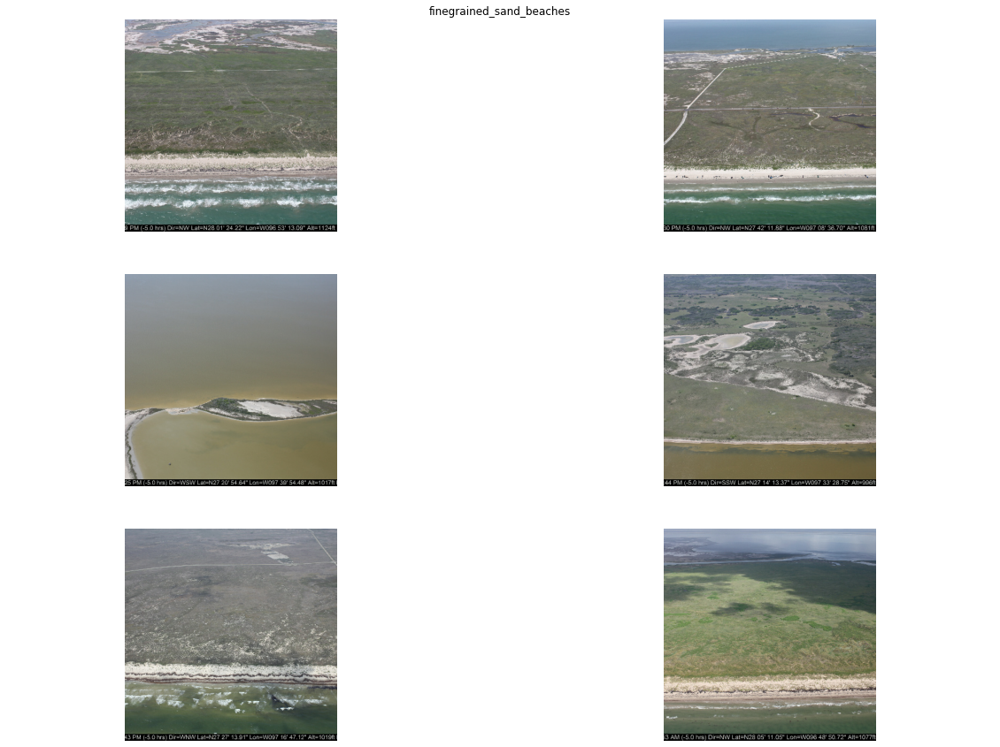

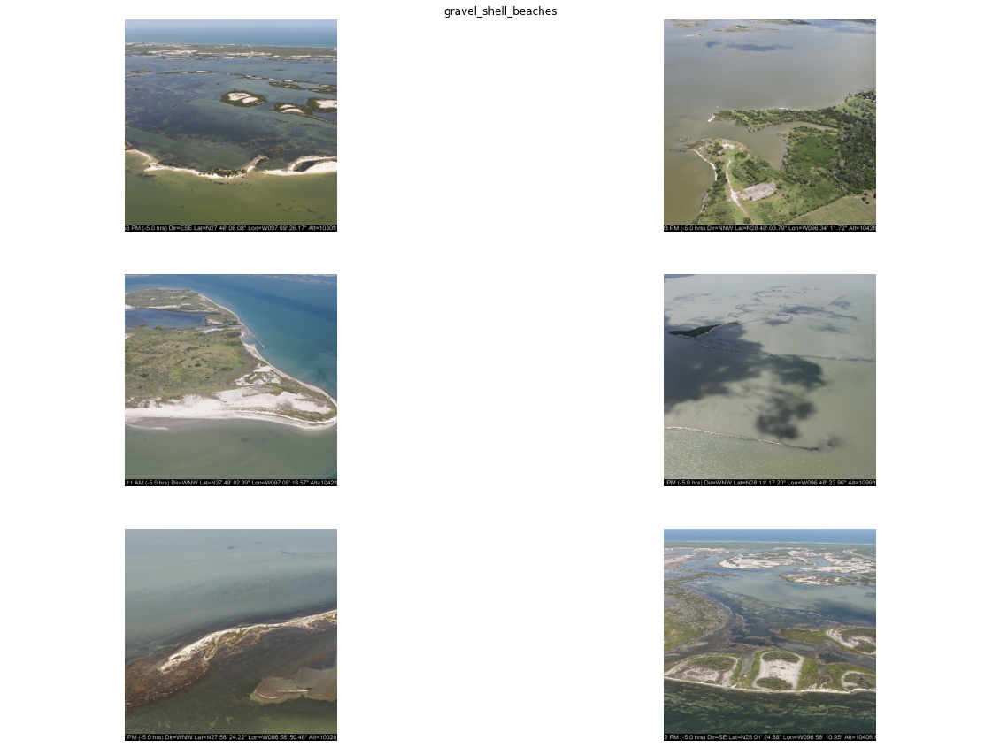

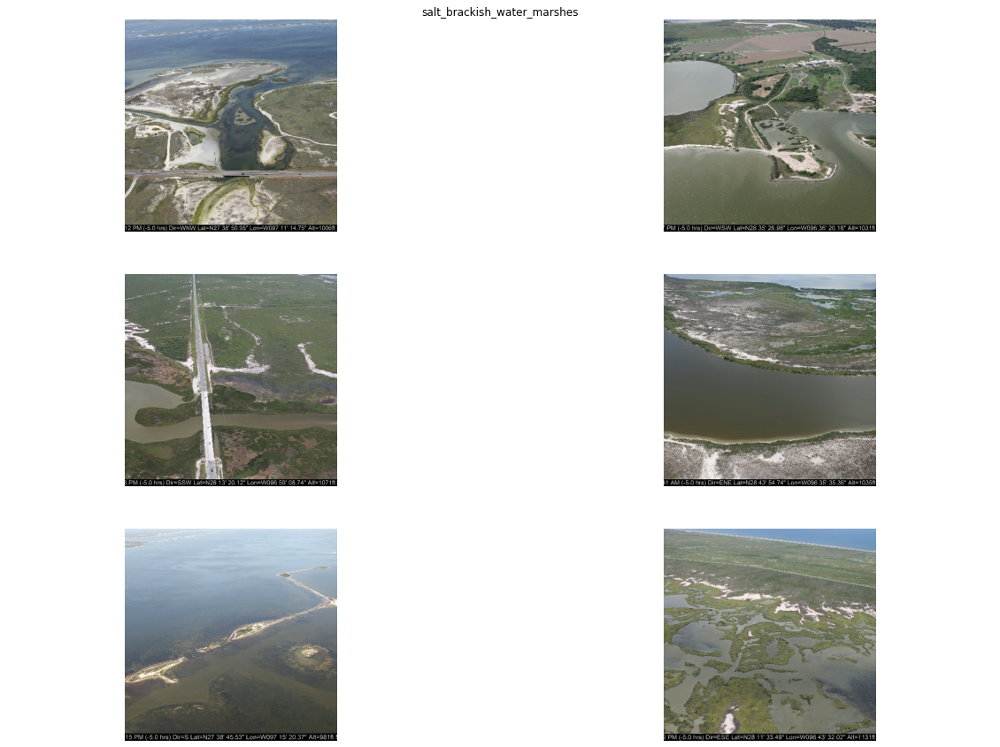

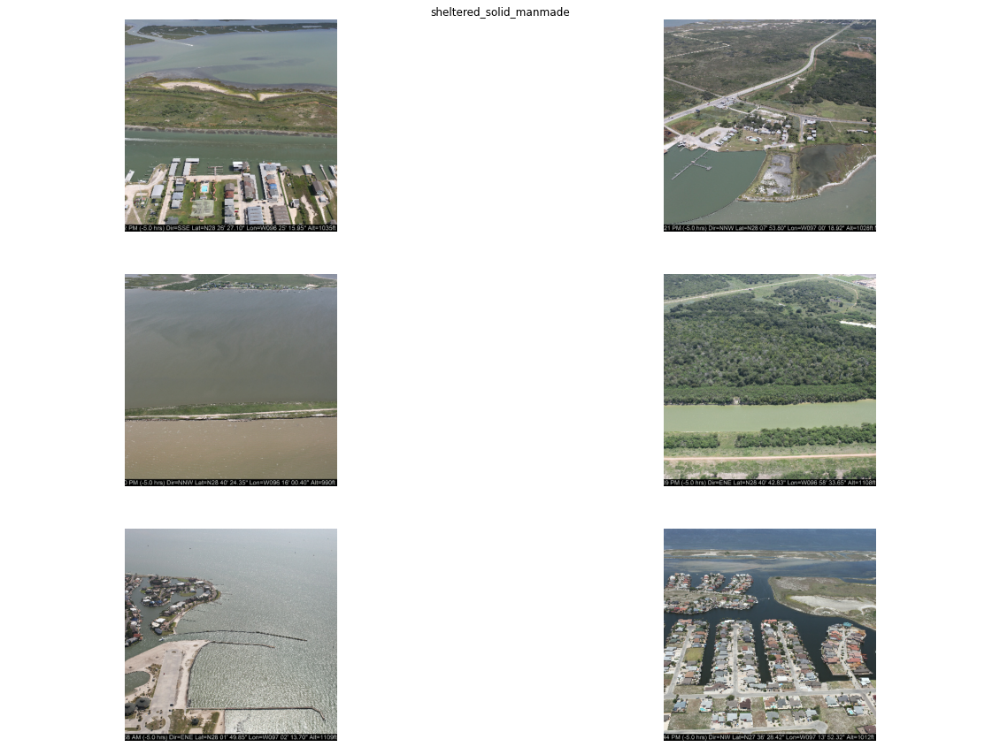

In [16]:
for class_idx in range(len(CLASSES)): # [0,1,2]:
  #show_one_class(class_idx=class_idx, bs=64)
  locs = np.where(ytrain == class_idx)
  samples = locs[:][0]
  #random.shuffle(samples)
  samples = samples[:bs]
  print("Total number of {} (s) in the dataset: {}".format(CLASSES[class_idx], len(locs[:][0])))
  X_subset = X_train[samples]
  plot_one_class(X_subset, samples, class_idx, bs, CLASSES, rows=3, cols=2)
  # plt.savefig( os.getcwd()+os.sep+'results/tamucc_sample_4class_samples_'+CLASSES[class_idx]+'.png', dpi=200, bbox_inches='tight')
  # plt.close('all')

What have we seen?
- At 400 pixels, the images are of sufficient resolution to resolve the distinguishing features, therefore sufficient to distinguish between the classes

- There are some mislabeled examples for a lot of classes
- There is inconsistency in labeling. 
- There are some images where multiple classes are present (the imagery represents a large area)

#### Mean Class Image
Let's compute the mean image for each class in the training set. This might give us a rough idea of what the most popular colour is per class, what the average pose of the object is. 

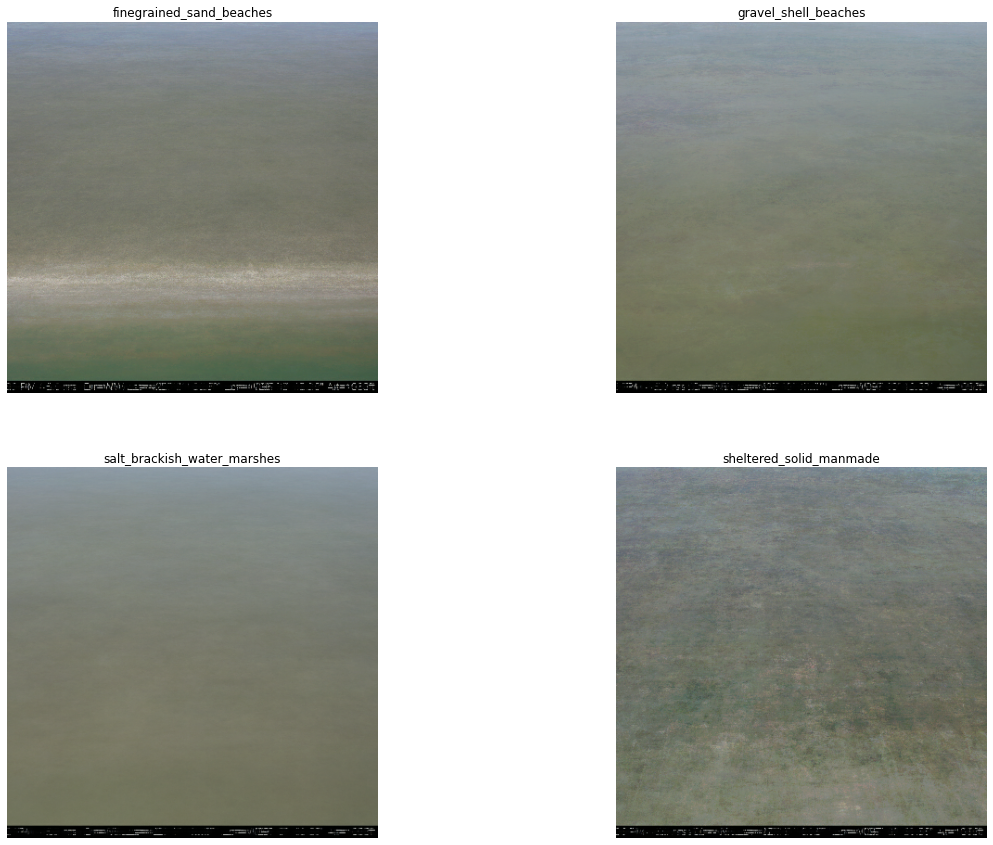

In [17]:
# plot mean images per class
plot_mean_images(X_train, ytrain, CLASSES, rows=2, cols=2)

#### Plot per-channel and per-class histograms

Sometimes it can be revealing to view differences between classes based on their RGB histogram patterns

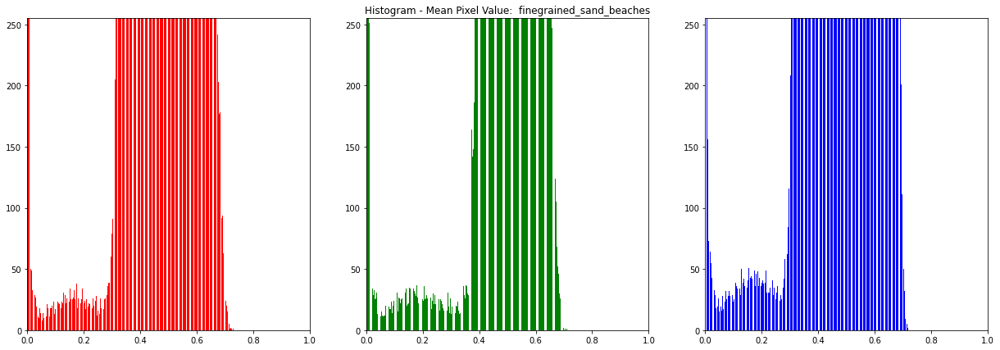

In [18]:
#### plot histograms
plot_distribution(X_train, ytrain, 0, CLASSES)

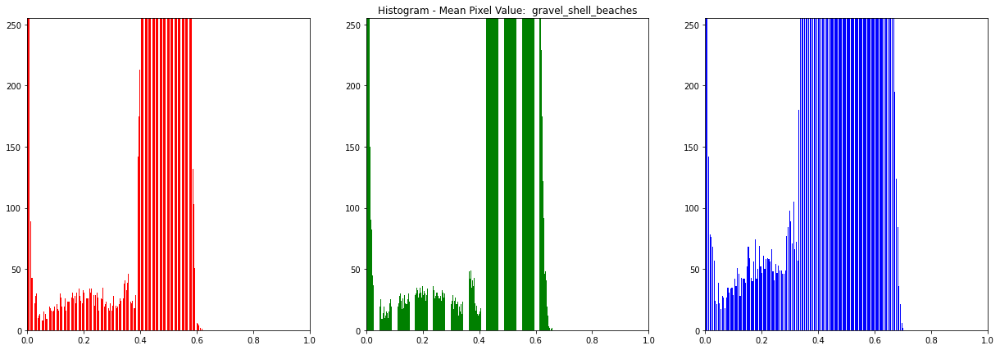

In [19]:
plot_distribution(X_train, ytrain, 1, CLASSES)

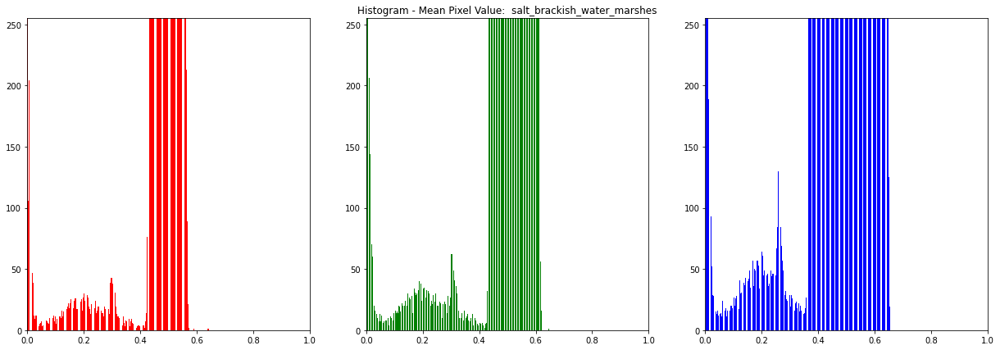

In [20]:
plot_distribution(X_train, ytrain, 2, CLASSES)

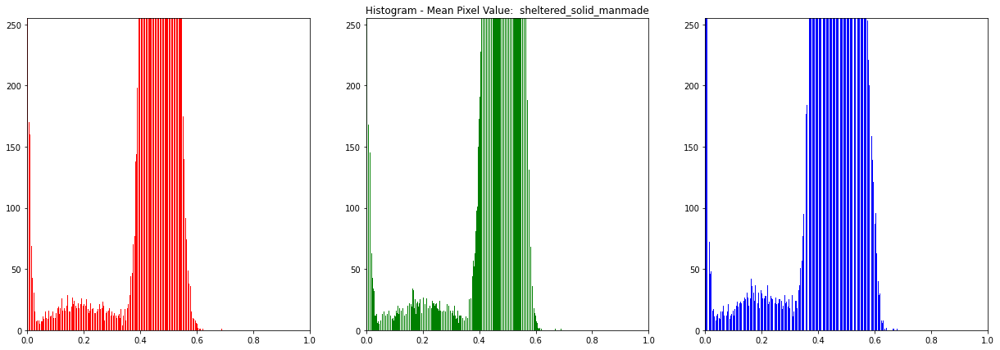

In [21]:
plot_distribution(X_train, ytrain, 3, CLASSES)

#### PCA for dimensionality reduction

In [22]:
num_samples = 500
X_subset = X_train[:num_samples]
X_subset = X_subset.reshape(num_samples,-1)
y_subset = ytrain[:num_samples]

Specify the number of principal components to use. The more you use, the more variance in the data will be captured, however the harder it will be to make a generalizable t-SNE model in the next step to visualize the classes in embedding space

In [25]:
num_components=100
pca = PCA(n_components=num_components)
reduced = pca.fit_transform(X_subset)
print('Cumulative variance explained by {} principal components: {}'.format(num_components, np.sum(pca.explained_variance_ratio_)))

Cumulative variance explained by 100 principal components: 0.7044090476190361


#### TSNE for embedding and visualization

There are 100 PCA components that are hard to collectively visualize, so we use the t-SNE algorithm to further embed those data into just 3 components that we can potentially visualize

In [26]:
# Create tsne plot
tsne = TSNE(n_components=3,n_jobs=-1)
tsne_result = tsne.fit_transform(reduced)
tsne_result_scaled = StandardScaler().fit_transform(tsne_result)

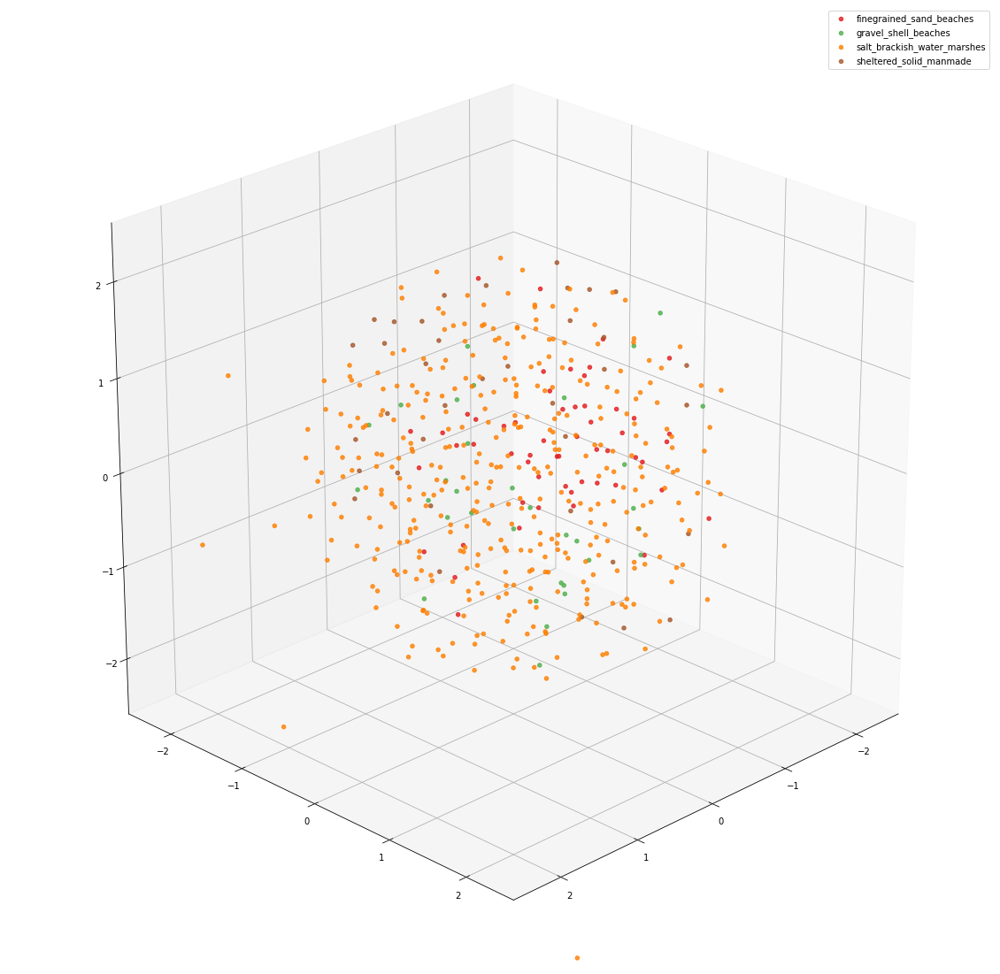

In [29]:
fig, ax = plot_tsne(tsne_result_scaled,ytrain, CLASSES)

Below we visualize the first two t-SNE embeddings as coloured dots and thumbnails. I have specified `xlim` and `ylim` arguments to not visualize the outliers.

Play with different numbers of PCA components and t-SNE components, but it will be hard to see a pattern. Traditional unsupervised learning like this, on data-class complexity like this(!), is going to be difficult to optimize.

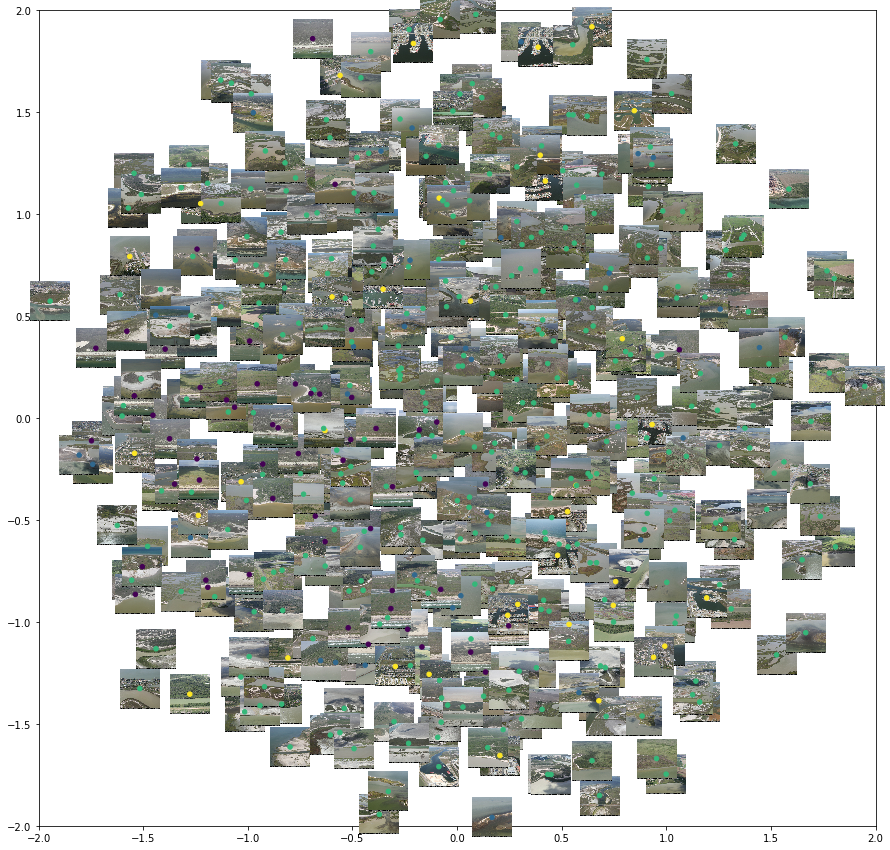

In [30]:
X_subset = X_train[:num_samples]
y_subset = ytrain[:num_samples]


f = visualize_scatter_with_images(tsne_result_scaled, y_subset,
                                  images = [np.reshape(i, (TARGET_SIZE,TARGET_SIZE,3)) for i in X_subset],
                                  image_zoom=0.1, xlim = (-2,2), ylim=(-2,2))

Difficult to visualize a pattern! But the blue dots (finegrained_sand_beaches) plot more to the left and the green dots (salt_brackish_water_marshes) plot more to the right. SO there is *some* discoverable pattern in this data, but takes sophisticated dimensionality reduction to reveal it

In [32]:
%whos ndarray

Variable             Type       Data/Info
-----------------------------------------
X_subset             ndarray    500x400x400x3: 240000000 elems, type `uint8`, 240000000 bytes (228.8818359375 Mb)
X_train              ndarray    500x400x400x3: 240000000 elems, type `uint8`, 240000000 bytes (228.8818359375 Mb)
n                    ndarray    4: 4 elems, type `int64`, 32 bytes
reduced              ndarray    500x100: 50000 elems, type `float64`, 400000 bytes (390.625 kb)
samples              ndarray    6: 6 elems, type `int64`, 48 bytes
tsne_result          ndarray    500x3: 1500 elems, type `float32`, 6000 bytes
tsne_result_scaled   ndarray    500x3: 1500 elems, type `float32`, 6000 bytes
y_subset             ndarray    500: 500 elems, type `int32`, 2000 bytes
ytrain               ndarray    500: 500 elems, type `int32`, 2000 bytes


In [33]:
#del X_subset, X_train, reduced, samples, tsne_result, tsne_result_scaled, ytrain

### NWPU visualization

The above workflow is adapted for the NWPU dataset and encoded in the following python script:

In [34]:
#!python nwpu_dataviz.py

What does it show?

First, t-SNE is a really effective way to embed and visualize classes on this dataset

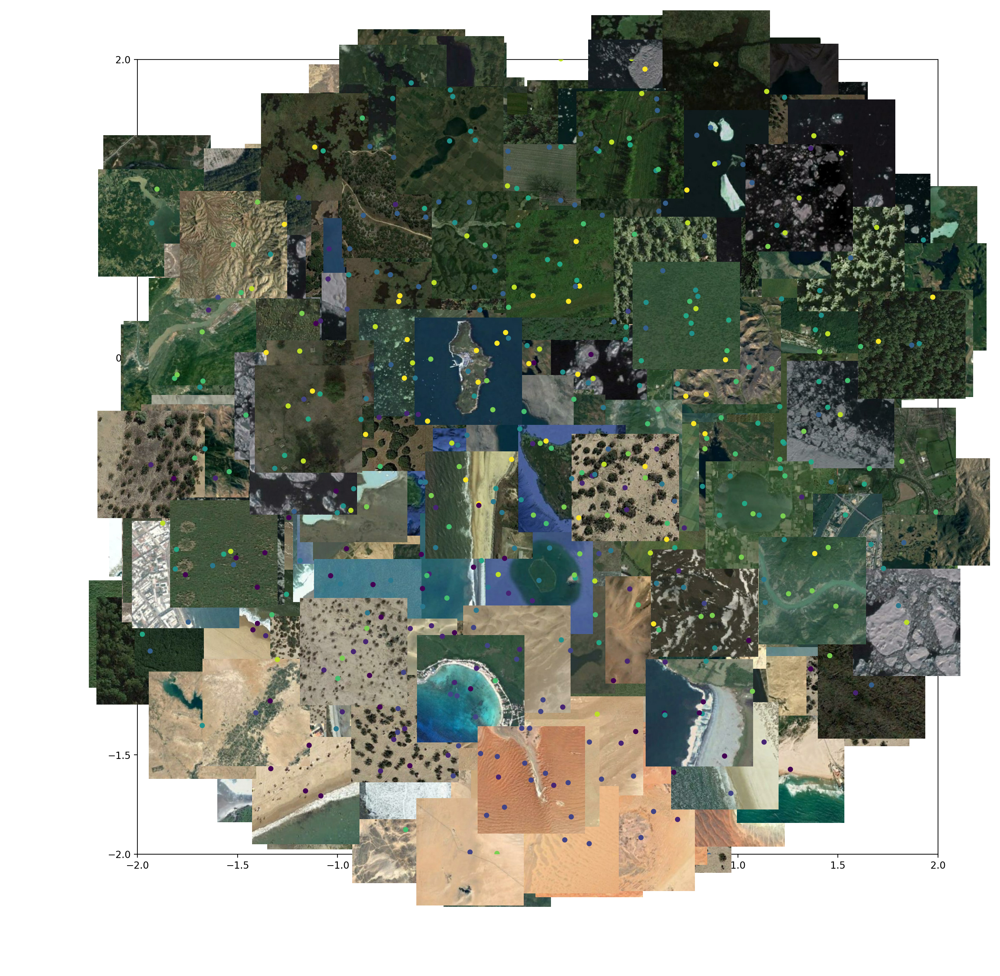

In [35]:
from IPython.display import Image
Image(filename = os.getcwd()+os.sep + "results/nwpu_sample_11class_tsne_vizimages_sample.png", width=500, height=500)

The mean image also shows that there are big differences between classes based on mean colour

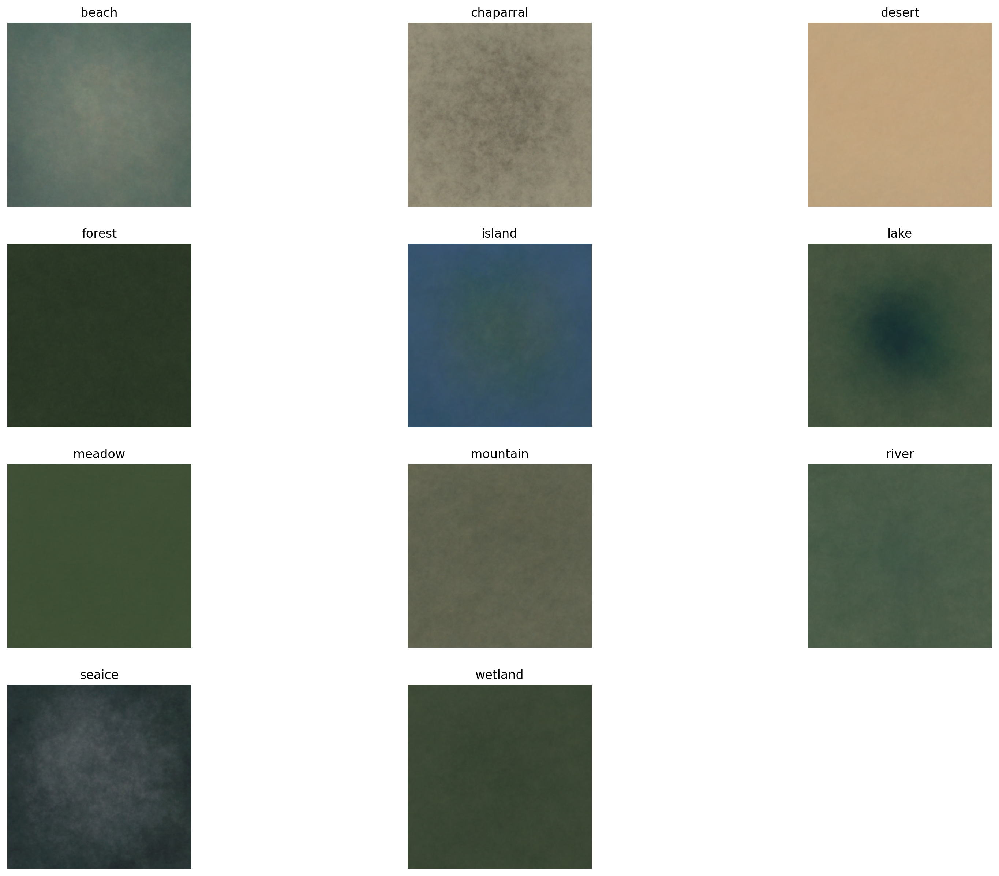

In [36]:
Image(filename = os.getcwd()+os.sep + "results/nwpu_sample_11class_mean.png", width=500, height=500)

The above is due to a larger degree of uniformity within classes, for example

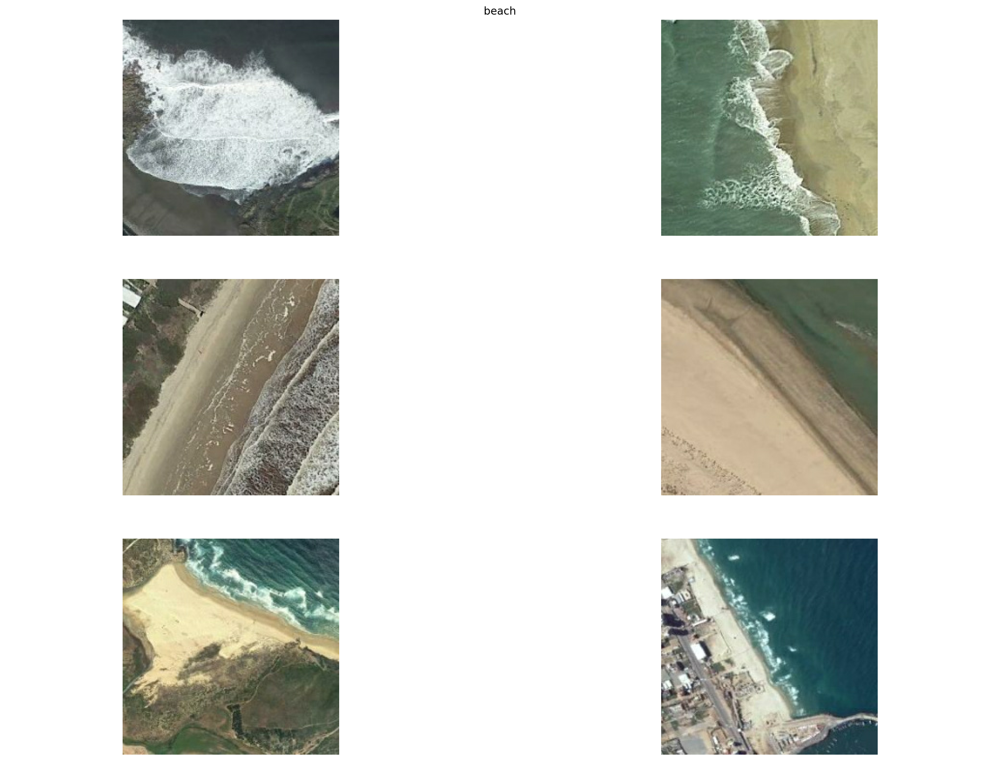

In [37]:
Image(filename = os.getcwd()+os.sep + "results/nwpu_sample_11class_samples_beach.png", width=500, height=500)

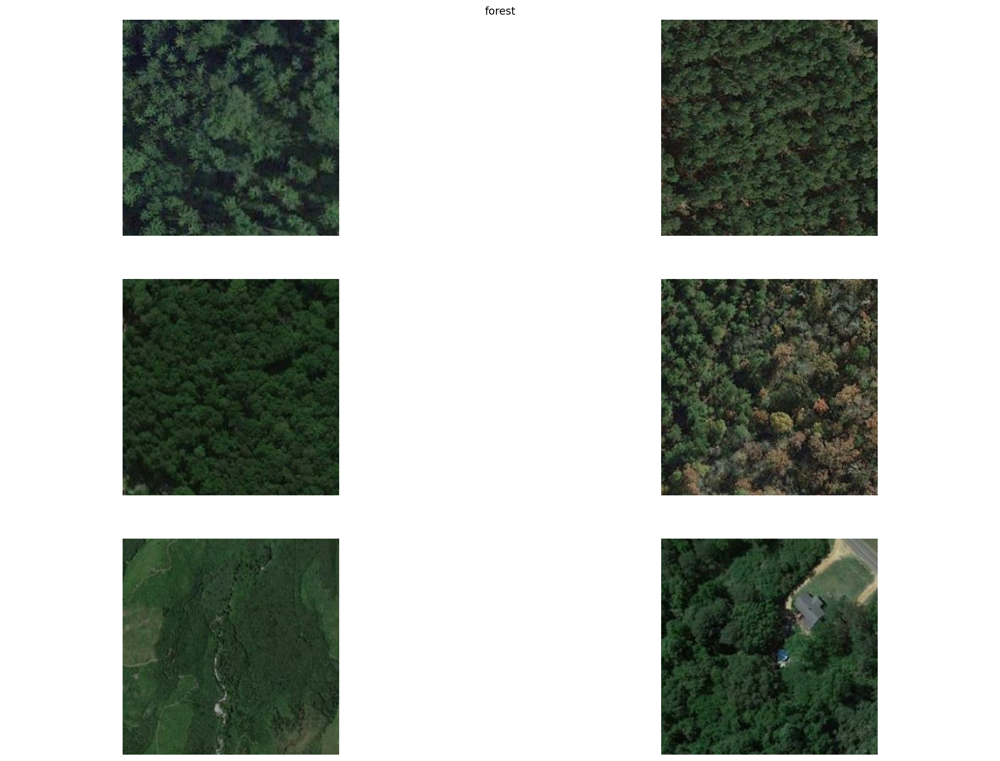

In [38]:
Image(filename = os.getcwd()+os.sep + "results/nwpu_sample_11class_samples_forest.png", width=500, height=500)